## Urbane mobilitets- og bygningsindikatorer: En analyse av bysykkelbruk og arealstruktur i Ullern og Grünerløkka.

## **Importering av funksjoner og bibliotek**

Under importerer jeg alle funksjonene som brukes videre i analysen.  
Disse er organisert i egne moduler for:

- lesing av data
- dataprosessering
- indikatorberegning
- visualisering
- interaktive kart


In [1]:
import pathlib
from lese_data import data_til_gdf, csv_til_df
from data_prosessering import punkter_gdf, legg_til_bydeler, hent_bygninger
from indikatorer import mobilitetsindikatorer, bygningsindikatorer
from visualisering import plot_mobilitetsindikatorer, plot_tidsprofil, plot_tidsprofil_retninger, plot_bygningsindikatorer, plot_bygningstyper
from map import interaktivt_kart

## **Steg 1: Dataprosessering**

Her leser jeg inn de tre datasettene som brukes i analysen:

- **bydelsgrenser** (GeoJSON)
- **historiske sykkelturer** (CSV)
- **bygninger** hentet fra OpenStreetMap via `hent_bygninger()`

Alle datasett reprojiseres til felles CRS (`EPSG:25833`) slik at areal-, avstands- 
og overlay-operasjoner blir korrekte.

In [2]:
NOTEBOOK_PATH = pathlib.Path().resolve()
BYDEL_FIL = NOTEBOOK_PATH / "data" / "oslo_bydeler_befolkning_2024.geojson"
TUR_HISTORIKK_FIL = NOTEBOOK_PATH / "data" / "sykkel_oktober_2025.csv"
TARGET_CRS = "EPSG:25833"

# Leser inn data
bydeler = data_til_gdf(BYDEL_FIL)
turer = csv_til_df(TUR_HISTORIKK_FIL)
bygninger = hent_bygninger(bydeler)

### Forhåndsvisning av data

Før jeg går videre, sjekker jeg at filene er lastet inn riktig.

In [3]:
bydeler.head(1)

,fid,bydelsnr,bynavn,bydel,befolkning_2024,geometry
0,1,030101,Oslo,Gamle Oslo,63721,"MULTIPOLYGON (((257239.61 6646410.66, 257463.2..."


In [4]:
turer.head(1)

,started_at,ended_at,duration,start_station_id,start_station_name,start_station_description,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_description,end_station_latitude,end_station_longitude
0,2025-10-01 03:02:11.567000+00:00,2025-10-01 03:13:40.482000+00:00,688,578,Hallings gate,langs Dalsbergstien,59.922777,10.738655,484,Karenslyst allé,ved Skabos vei,59.92033,10.683814


I `turer` ligger posisjonene til start- og sluttstasjon som separate kolonner.
For å gjøre kodens struktur tydelig definerer jeg navnene på disse kolonnene eksplisitt. Det samme gjelder kolonnen med bydelnavnene.

In [5]:
start_lat = "start_station_latitude"
start_lon = "start_station_longitude"
slutt_lat = "end_station_latitude"
slutt_lon = "end_station_longitude"
bydel_col = "bydel"

### Knytte sykkelturer til bydeler

For å kunne analysere mobiliteten per bydel, konverterer jeg først start- og sluttposisjonene 
til sykkelturene til GeoDataFrames. Deretter bruker jeg romlig join for å avgjøre hvilken 
bydel hver tur både starter og slutter i.

Resultatet er et datasett som inneholder informasjon om:
- hvilken bydel turen starter i
- hvilken bydel turen slutter i
- alle turattributter (tid, stasjon, lengde, etc.)


In [6]:
# Lage GeoDataFrame for start- og sluttpunkter
start_gdf = punkter_gdf(turer, start_lat, start_lon, target_crs=TARGET_CRS)
slutt_gdf = punkter_gdf(turer, slutt_lat, slutt_lon, target_crs=TARGET_CRS)

# Koble start- og sluttpunkter til bydeler
turer_i_bydeler = legg_til_bydeler(turer, start_gdf, slutt_gdf, bydeler, bydel_col)

## **Steg 2: Indikatorberegning**

### Mobilitetsindikatorer
`mobilitetsindikatorer()` beregner blant annet:

- antall turer som starter i bydelen
- antall turer som slutter i bydelen
- netto turer (inn − ut)
- indikatorer per $\text{km}^2$
- indikatorer per innbygger

### Bygningsindikatorer
`bygningsindikatorer()` beregner blant annet:

- totalt antall bygninger per bydel  
- bygningstetthet (antall bygninger per $\text{km}^2$)  
- samlet bygningsareal

De to indikator-dataene slås sammen til en GeoDataFrame (`indikatorer`), som brukes videre.

In [7]:
# Beregner mobilitetsindikatorer og bygninsindikatorer
mob_ind = mobilitetsindikatorer(bydeler, turer_i_bydeler)
bygg_ind = bygningsindikatorer(bygninger, bydeler)

Bygningsindikatorene inneholder også `areal_km2` og `befolkning_2024`, som allerede finnes
i mobilitetsindikatorene. Jeg fjerner derfor disse duplikatene før merging.


In [8]:
# Slår sammen mob_ind og bygg_ind til en GeoDataFrame
bygg_ind = bygg_ind.drop(columns=[bygg_ind.geometry.name, "areal_km2", "befolkning_2024"])
indikatorer = mob_ind.merge(bygg_ind, how="left", on="bydel")

## **Steg 3: Visualiseringer**

### Mobilitetsindikatorer

Figuren under viser et sett med mobilitetsindikatorer for Ullern og Grünerløkka.

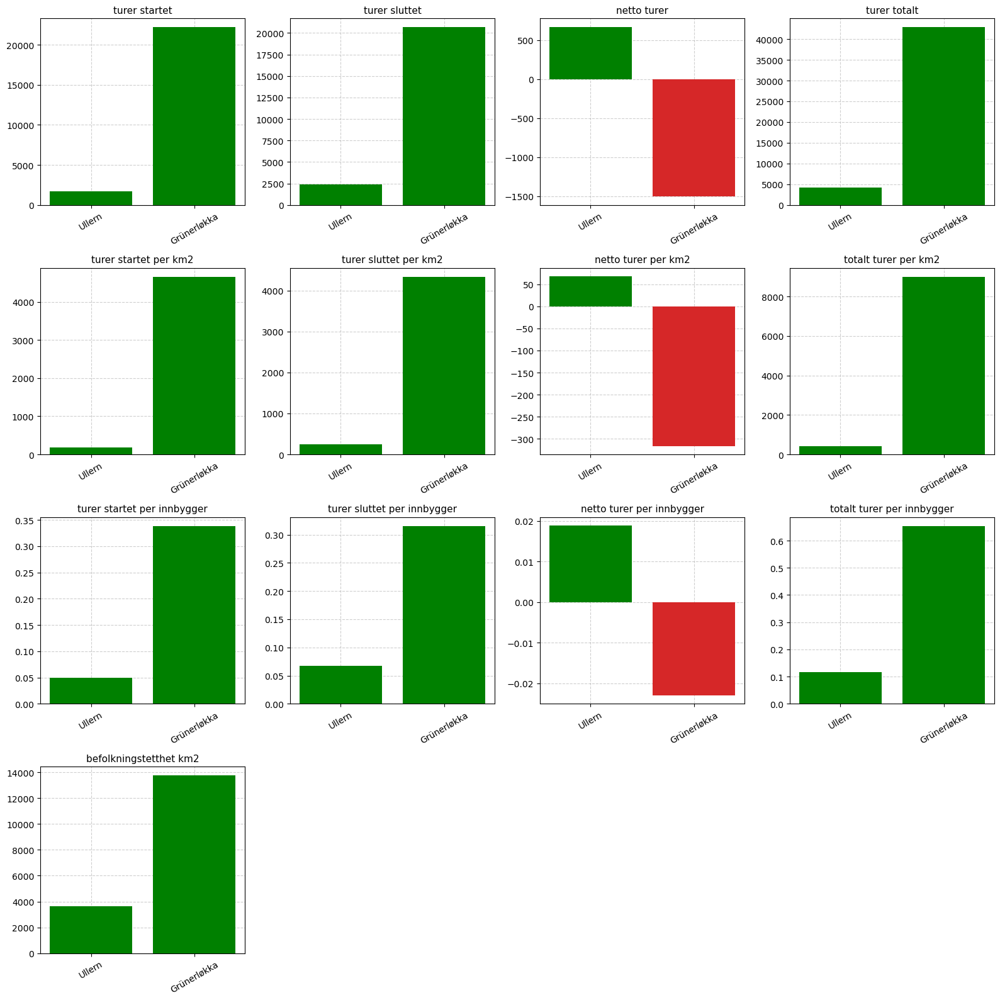

In [9]:
mob_inf_fig = plot_mobilitetsindikatorer(indikatorer, bydel_a="Ullern", bydel_b="Grünerløkka")

Grünerløkka har et høyere volum av både startende og sluttende turer, 
noe som stemmer godt med bydelens høyere befolkningstetthet og mer sentrale beliggenhet.

Grünerløkka har en negativ nettoverdi i løpet av perioden, altså flere turer slutter enn starter, mens Ullern har en svak positiv netto, noe som tyder på at flere sykler inn enn ut av bydelen. 
Ser vi på turer per arealet til bydelen er forskjellen enorm. Grünerløkka har mange ganger høyere tetthet av turer. Dette skyldes nom at bydelen er liten, tett befolket og full av destinasjoner/aktiviteter. Selv når det normaliseres for befolkning, sykles det mye mer i Grünerløkka, som viser at mobiliteten ikke kun skyldes befolkning, men også bystruktur og aktivitetstilbud.
Grünerløkka har høyere befolkningstetthet enn Ullern. Men det er kombinasjonen av høy befolkningstetthet og funksjonen til byen (restauranter, kultur, handel) som gir høyt mobilitetsnivå.

Mobilitetsindikatorene peker mot at Grünerløkka fungerer som et større mobilitetsknutepunkt i byen, mens Ullern har et mye roligere mobilitetsmønster.


### Døgnprofil

Figuren under viser hvordan sykkelturene fordeler seg over døgnet for de to bydelene.

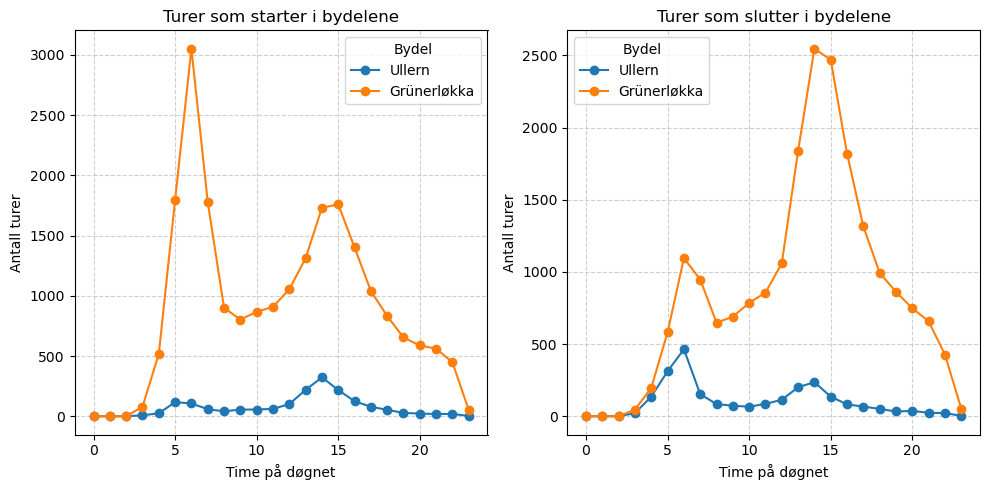

In [10]:
døgnprofil = plot_tidsprofil(turer_i_bydeler, bydel_a="Ullern", bydel_b="Grünerløkka")

Grünerløkka har to tydelige topper. Det er morgenrush rundt kl. 08, og ettermiddagsrush rundt kl. 15, noe som er typisk for en sentral og travel bydel.
Ullern har langt lavere volum, men følger samme rytme. Det er færre som starter turen her, men det er en tydelig pendlerprofil.
Dette støtter opp under mobilitetsindikatorene.

Grünerløkka har et sterkt aktivitetsdøgn med mange formål, jobb, handel, servering, mens Ullern primært genererer turer knyttet til pendling til og fra jobb.
Dette døgnmønsteret er typisk for byområder med forskjellig befolkningstetthet og funksjon (boligområde eller sentrum).

### Døgnprofil for turer mellom bydelene

Denne figuren viser turer fra Ullern til Grünerløkka og fra Grünerløkka til Ullern.

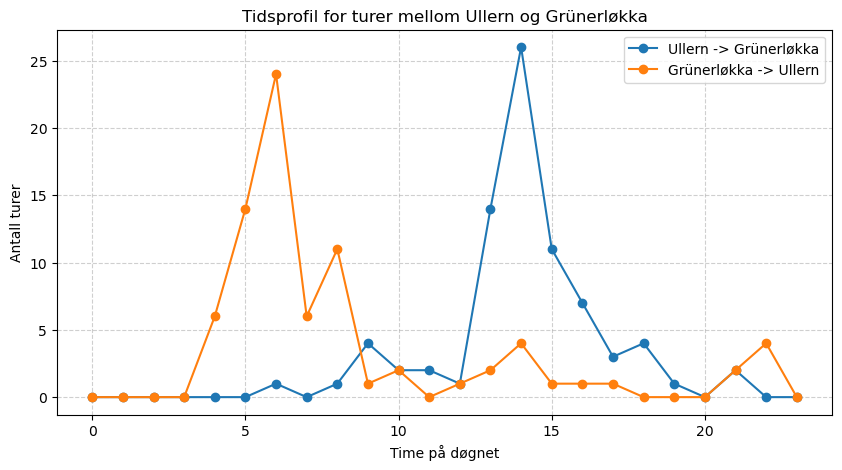

In [11]:
døgnprofil_retning = plot_tidsprofil_retninger(turer_i_bydeler, bydel_a="Ullern", bydel_b="Grünerløkka")

Det er flest turer fra Grünerløkka til Ullern om morgenen. Dette indikerer at flere personer bor i Grünerløkka og pendler mot vest. Det gir mening, 
ettersom det er mye næringsvirksomhet i området rundt Skøyen. 
På ettermiddagen skjer det motsatte. Det er flere turer fra Ullern til Grünerløkka, sannsynligvis tilbake hjem fra jobb.

Dette viser tydelig en pendlerretning mellom bydelene.

### Bygningsindikatorer
Denne figuren viser et sett med indikatorer for bygningner i Ullern og Grünerløkka:

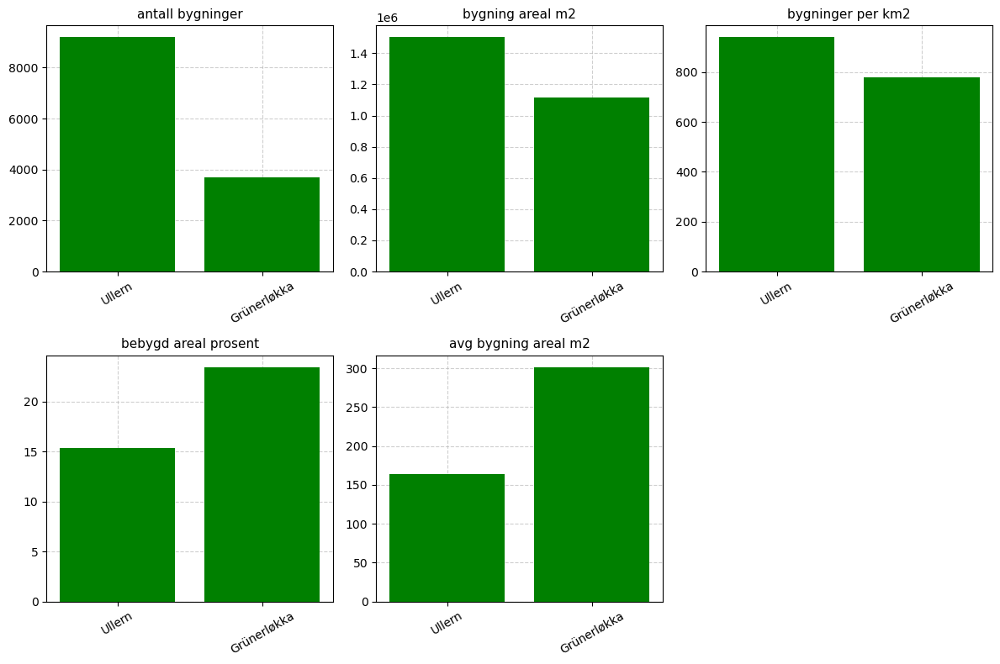

In [12]:
bygg_ind_fig = plot_bygningsindikatorer(indikatorer, bydel_a="Ullern", bydel_b="Grünerløkka")

Ullern har flere bygninger totalt, men fordi bydelen er svært stor arealmessig blir bygningstettheten lav sammenlignet med Grünerløkka. Grünerløkka har et betydelig høyere bebygd areal i prosent. Gjennomsnittlig bygningstørrelse $\text{km}^2$ er større i Grünerløkka, noe som gjenspeiler at mange av byggene er blokker og større boligkomplekser.

Disse forskjellene understøtter funnene fra mobilitetsindikatorenel. Høy befolkningstetthet tetthet, tilbud i bydelen og boligtype
gir mer tilgjengelighet og kortere avstander, som igjen bidrar til høyere sykkelbruk.

### Bygningstyper i Ullern og Grünerløkka

Figuren viser fordeling av utvalgte bygningstyper i de to bydelene.

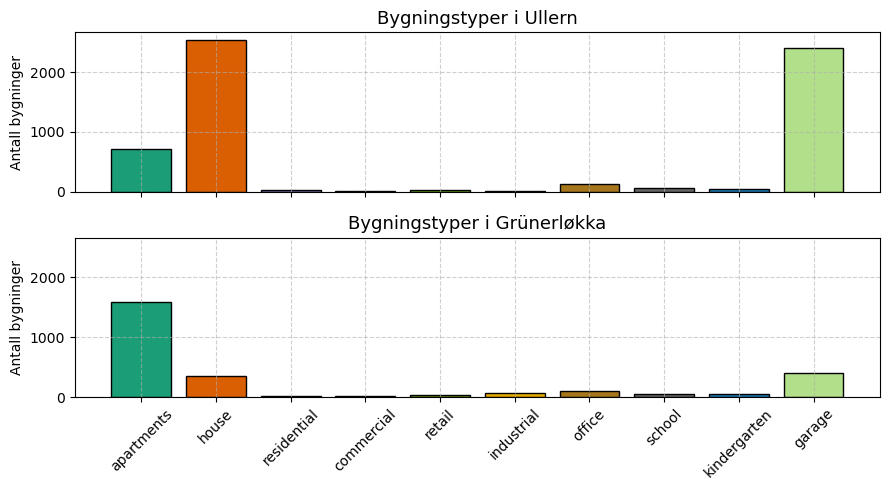

In [13]:
bygg_type = ["apartments", "house", "residential", "commercial", "retail", 
            "industrial", "office", "school", "kindergarten", "restaurant",
            "garage"]

bygningstyper = plot_bygningstyper(bygninger, bydel_a="Ullern", bydel_b="Grünerløkka", typer=bygg_type)

Grünerløkka domineres av leilighetsbygg, men har små innslag av kontor og handelsrelaterte bygninger.
Ullern har en stor andel eneboliger/hus og garasjer, noe som indikerer at bydelen preges av boligfelt.

I sammenheng med mobilitet så ser man at bydeler med høy boligkonsentrasjon og lav befolkningstetthet (som Ullern) genererer få sykkelturer. At antallet garasjer er så høyt i Ullern indikierer at det også er mye biler det. Mange kjører nok derfor da bil fremfor sykkel derifra. Mens bydeler med mye funksjonsblanding og høy befolkningstetthet (som Grünerløkka) skaper hyppig og variert mobilitet, med sykkel. 

Bygningstypene forklarer derfor mobilitetsforskjellene fra tidligere.

## **Steg 4: Interaktivt kart**

Til slutt kombinerer jeg mobilitetsdata og bygningsdata i et interaktivt kart.

Kartet viser:
- **Choropleth:** totalt antall turer for hver av de to valgte bydelene, per $\text{km}^2$.
- **Popup-vinduer**: gir indikatorer som:
  - areal  
  - befolkning  
  - befolkningstetthet  
  - netto turer per km²  
  - netto turer per innbygger  

- **Bygningslag:** individuelle bygg fargelagt etter type.

In [14]:
popup_cols = ["bydel", "areal_km2", "befolkningstetthet_km2", "befolkning_2024", "netto_turer_per_km2", "netto_turer_per_innbygger"]

kart = interaktivt_kart(
    indikatorer,
    bygninger,
    choropleth_col="totalt_turer_per_km2",
    popup_cols=popup_cols,
    bydel_a="Ullern",
    bydel_b="Grünerløkka"
)

kart

Grünerløkka fremstår som svært tett og funksjonsrik, mens Ullern viser spredt bebyggelse og få bygningstyper, i tråd med indikatorene.
Bygningstettheten og typefordelingen korresponderer med intensiteten av sykkelbruk i kartet.

Kartet understøtter derfor tidligere analyser og gir en helhetlig forståelse av mobilitet og bygninger.

Jeg bruker turer per $\text{km}^2$ som choropleth-variabel fordi dette korrigerer for forskjeller i areal mellom
bydelene, og gjør mobilitetsnivået mer sammenlignbart.